# Process Velocity Data

This notebook goes through the steps to process raw .pkl files into a usable format by
1. Extracting data for each earthquake as well as earthquake metadata
2. Selecting a subset of stations out of all those with data to perform analysis
3. Compress data via subsampling

NOTE: Scale acceleration values in the future to account for scaled station values. Look at acceleration notebook for fix

In [6]:
## Imports

import pickle
from pathlib import Path
import datetime
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib 
import seaborn as sns; sns.set()
matplotlib.rc('font', **{'size': 18})
import numpy as np
import json

In [24]:
load_path = '../data/Ridgecrest/'
data_dir = "../data/"
raw_path = os.path.join(data_dir, "raw")
meta_path = os.path.join(data_dir, "metadata")
relevant_path = os.path.join(data_dir, "vel", "relevant_stations")
compressed_path = os.path.join(data_dir, "vel", "compressed")

freq = 100 #Number of samples per second 

### Step-1: Extract data for earthquakes

#### Part a: Extract accelerations

In [3]:
def get_indices(station_start_time, earthquake_start_time, period = 6000, step=100, offset=15):
    start_idx = int(100*(earthquake_start_time - station_start_time)) - offset*step
    end_idx = start_idx + period
    return (start_idx, end_idx)


In [ ]:
input_dir = Path(load_path)

output_dir = Path(raw_path)
output_files = [os.path.split(f)[1].split('.')[0] for f in sorted(output_dir.glob("*.npy"))]
print(output_files)

if not os.path.exists(raw_path):
    os.mkdir(raw_path)

def np_from_pkl(data_path, save_path, period = 6000):
    input_dir = Path(data_path)
    sorted(input_dir.glob("*.pkl"))
    for f in tqdm(sorted(input_dir.glob("*.pkl"))):
#         print(f)
        day_id = os.path.split(f)[1].split('.')[0]
#         if day_id in output_files: 
#             print("File found for date: {}".format(day_id))
#             continue
        ## Iterating over pickles
        stations = []
        with open(f, 'rb') as fp:
            try:
                data = pickle.load(fp)
            except:
                print("Pickle Corrupted")
                print("Corrupted path: {}".format(f))
                continue
            num_stations, num_events = len(data['stations']), len(data['events'])
#             data_arr = np.zeros

            for station in data['stations']:
                events = []
                for event in data['events']:
                    start_idx, end_idx = get_indices(data['stations'][station]['starttime'], event['time'])
                    if (end_idx > len(data['stations'][station]['data']) - 1) or (start_idx < 0):
                        continue #skip event
                    events.append(np.transpose(data['stations'][station]['data'][start_idx: end_idx], (1, 0)))
                events = np.array(events)
#                 print("events shape", events.shape)
                stations.append(events)
        save_arr = np.array(stations) 
#         print("station shape: ", save_arr.shape)
        filename = day_id + ".npy"
        np.save(os.path.join(save_path, filename), save_arr) 
        
np_from_pkl(load_path, raw_path)


#### Part b: Extract metadata

In [ ]:
## Reads through pickles. Saves stations and events (w/o the big boy quake data)    

if not os.path.exists(meta_path):
    os.mkdir(meta_path)
    
def save_station_and_events(data_path, save_path):
    dropped = []
    input_dir = Path(data_path)
    sorted(input_dir.glob("*.pkl"))
    for f in tqdm(sorted(input_dir.glob("*.pkl"))):
        print(f)
        day_id = os.path.split(f)[1].split('.')[0]
        ## Iterating over pickles
#         stations = []
        with open(f, 'rb') as fp:
            try:
                data = pickle.load(fp)
            except:
                print("Pickle Corrupted")
                print("Corrupted path: {}".format(f))
                continue
                
        first_stat = list(data['stations'].keys())[0]
        filename = day_id + "_meta.json"
                
        ## Idxs to keep
        idxs_to_keep = []
        for e, event in enumerate(data['events']):
            start_idx, end_idx = get_indices(data['stations'][first_stat]['starttime'], event['time'])
            if (end_idx > len(data['stations'][first_stat]['data']) - 1) or (start_idx < 0):
                ## Event was skipped
                pass
            else:
                idxs_to_keep.append(e)
        before = len(data['events'])
        data['events'] = [data['events'][idx] for idx in idxs_to_keep]
        after = len(data['events'])
        print("Num events dropped from date {}: {}".format(day_id, before - after))
        dropped.append(before - after)
        for station in data['stations']:
#             print(data['stations'][station].keys())
            for key in ['starttime', 'endtime', 'data']:
                del data['stations'][station][key]            
        for e, event in enumerate(data['events']):
            del data['events'][e]['time']
#         print(data)
        stations = np.array([stat for stat in data['stations'].keys()])
        print(stations)
        np.save(os.path.join(save_path, "{}_stations.npy".format(day_id)), stations)
        with open(os.path.join(save_path, filename), 'w') as fp:
            json.dump(data, fp)      
    with open(os.path.join(save_path, "dropped_events.txt"), 'w') as fp:
        fp.write(str(sum(dropped)) + '\n')
        for d in dropped:
            fp.write(str(d)+'\n')
        
save_station_and_events(load_path, meta_path)

#### Part c: Get shapes for all dates

In [14]:
files = [entry for entry in os.scandir(raw_path)]
print(len(files))

122


In [37]:
stations, events = [], []
for file in files:
#     print(np.load(os.path.join(data_path, file)).shape)
    temp = np.load(file)
    print(temp.shape)
    stations.append(temp.shape[0])
    events.append(temp.shape[1])
    del temp


(23, 94, 3, 6000)
(16, 3, 3, 6000)
(31, 267, 3, 6000)
(28, 250, 3, 6000)
(16, 12, 3, 6000)
(19, 1235, 3, 6000)
(31, 559, 3, 6000)
(30, 739, 3, 6000)
(33, 243, 3, 6000)
(27, 244, 3, 6000)
(16, 10, 3, 6000)
(29, 245, 3, 6000)
(16, 11, 3, 6000)
(26, 118, 3, 6000)
(31, 275, 3, 6000)
(25, 158, 3, 6000)
(16, 7, 3, 6000)
(32, 257, 3, 6000)
(29, 644, 3, 6000)
(34, 551, 3, 6000)
(16, 11, 3, 6000)
(29, 744, 3, 6000)
(31, 134, 3, 6000)
(24, 144, 3, 6000)
(26, 123, 3, 6000)
(16, 4, 3, 6000)
(32, 229, 3, 6000)
(29, 647, 3, 6000)
(27, 271, 3, 6000)
(21, 1335, 3, 6000)
(25, 99, 3, 6000)
(32, 315, 3, 6000)
(32, 836, 3, 6000)
(23, 83, 3, 6000)
(16, 2, 3, 6000)
(16, 5, 3, 6000)
(32, 731, 3, 6000)
(34, 545, 3, 6000)
(30, 251, 3, 6000)
(29, 462, 3, 6000)
(31, 357, 3, 6000)
(16, 6, 3, 6000)
(31, 233, 3, 6000)
(31, 290, 3, 6000)
(16, 15, 3, 6000)
(16, 6, 3, 6000)
(17, 1895, 3, 6000)
(16, 4, 3, 6000)
(16, 4, 3, 6000)
(31, 285, 3, 6000)
(31, 228, 3, 6000)
(24, 131, 3, 6000)
(32, 294, 3, 6000)
(16, 20, 3, 6000

In [39]:
dates = [file.name for file in files]
stat_evs = zip(stations, events)

shapes = [(s, v, 3, 6000) for s, v in stat_evs]
mapping = dict(zip(dates, shapes))
print(mapping)

with open(os.path.join(meta_path, 'date_to_shape.json'), 'w') as fp:
    json.dump(mapping, fp)

{'2019-09-22.npy': (23, 94, 3, 6000), '2019-06-12.npy': (16, 3, 3, 6000), '2019-08-25.npy': (31, 267, 3, 6000), '2019-07-31.npy': (28, 250, 3, 6000), '2019-07-02.npy': (16, 12, 3, 6000), '2019-07-07.npy': (19, 1235, 3, 6000), '2019-07-19.npy': (31, 559, 3, 6000), '2019-07-17.npy': (30, 739, 3, 6000), '2019-08-15.npy': (33, 243, 3, 6000), '2019-08-04.npy': (27, 244, 3, 6000), '2019-06-10.npy': (16, 10, 3, 6000), '2019-08-10.npy': (29, 245, 3, 6000), '2019-06-26.npy': (16, 11, 3, 6000), '2019-09-30.npy': (26, 118, 3, 6000), '2019-08-26.npy': (31, 275, 3, 6000), '2019-09-13.npy': (25, 158, 3, 6000), '2019-06-29.npy': (16, 7, 3, 6000), '2019-08-13.npy': (32, 257, 3, 6000), '2019-07-26.npy': (29, 644, 3, 6000), '2019-07-21.npy': (34, 551, 3, 6000), '2019-06-08.npy': (16, 11, 3, 6000), '2019-07-15.npy': (29, 744, 3, 6000), '2019-09-06.npy': (31, 134, 3, 6000), '2019-09-11.npy': (24, 144, 3, 6000), '2019-09-26.npy': (26, 123, 3, 6000), '2019-06-04.npy': (16, 4, 3, 6000), '2019-08-16.npy': (32

#### Part d: Count number of quakes per station

In [40]:
station_files = [entry.name for entry in Path(meta_path).glob("*.npy")]
# print(station_files)

In [52]:
stations = []
for file in station_files:
    stations.append(np.load(os.path.join(meta_path, file)))
    
print(stations)

[array(['CI.CCC.', 'CI.DTP.', 'CI.JRC2.', 'CI.LRL.', 'CI.MPM.', 'CI.SLA.',
       'CI.SRT.', 'CI.TOW2.', 'CI.WBM.', 'CI.WCS2.', 'CI.WMF.', 'CI.WNM.',
       'CI.WRC2.', 'CI.WRV2.', 'CI.WVP2.', 'GS.CA01.20', 'GS.CA03.20',
       'GS.CA05.20', 'GS.CA06.20', 'GS.CA07.00', 'GS.CA08.00',
       'GS.CA09.00', 'GS.CA10.00', 'NP.5419.10'], dtype='<U10'), array(['CI.CCC.', 'CI.DTP.', 'CI.JRC2.', 'CI.LRL.', 'CI.MPM.', 'CI.SLA.',
       'CI.SRT.', 'CI.TOW2.', 'CI.WBM.', 'CI.WCS2.', 'CI.WMF.', 'CI.WNM.',
       'CI.WRC2.', 'CI.WRV2.', 'CI.WVP2.', 'GS.CA01.20', 'GS.CA03.20',
       'GS.CA05.20', 'GS.CA06.20', 'GS.CA07.00', 'GS.CA08.00',
       'GS.CA09.00', 'GS.CA10.00', 'NP.5419.10'], dtype='<U10'), array(['CI.CCC.', 'CI.DTP.', 'CI.JRC2.', 'CI.LRL.', 'CI.MPM.', 'CI.SLA.',
       'CI.SRT.', 'CI.TOW2.', 'CI.WBM.', 'CI.WCS2.', 'CI.WMF.', 'CI.WNM.',
       'CI.WRC2.', 'CI.WRV2.', 'CI.WVP2.', 'GS.CA01.20', 'GS.CA03.20',
       'GS.CA05.20', 'GS.CA06.20', 'GS.CA07.00', 'GS.CA08.00',
       'GS.CA09.00',

In [67]:
counts = {}
for v in stations:
    for stat in v:
        if stat not in counts:
            counts[stat] = 0
print("Stations: ", counts)
print(len(counts))

Stations:  {'CI.CCC.': 0, 'CI.DTP.': 0, 'CI.JRC2.': 0, 'CI.LRL.': 0, 'CI.MPM.': 0, 'CI.SLA.': 0, 'CI.SRT.': 0, 'CI.TOW2.': 0, 'CI.WBM.': 0, 'CI.WCS2.': 0, 'CI.WMF.': 0, 'CI.WNM.': 0, 'CI.WRC2.': 0, 'CI.WRV2.': 0, 'CI.WVP2.': 0, 'GS.CA01.20': 0, 'GS.CA03.20': 0, 'GS.CA05.20': 0, 'GS.CA06.20': 0, 'GS.CA07.00': 0, 'GS.CA08.00': 0, 'GS.CA09.00': 0, 'GS.CA10.00': 0, 'NP.5419.10': 0, 'ZY.SV01.': 0, 'ZY.SV06.': 0, 'ZY.SV08.': 0, 'CI.CLC.': 0, 'GS.CA04.20': 0, 'ZY.SV02.': 0, 'ZY.SV03.': 0, 'ZY.SV04.': 0, 'GS.CA02.20': 0, 'ZY.SV05.': 0, 'ZY.SV07.': 0, 'NP.5419.': 0}
36


In [60]:
date_to_shape = None
with open(os.path.join(meta_path, 'date_to_shape.json'), 'r') as json_file:
    date_to_shape = json.load(json_file)
    dates, shapes = zip(*date_to_shape.items())
    dates, shapes = list(dates), list(shapes)

# dates = [dates[i].split('.')[0] for i in range(len(dates))]
print(dates)

['2019-09-22.npy', '2019-06-12.npy', '2019-08-25.npy', '2019-07-31.npy', '2019-07-02.npy', '2019-07-07.npy', '2019-07-19.npy', '2019-07-17.npy', '2019-08-15.npy', '2019-08-04.npy', '2019-06-10.npy', '2019-08-10.npy', '2019-06-26.npy', '2019-09-30.npy', '2019-08-26.npy', '2019-09-13.npy', '2019-06-29.npy', '2019-08-13.npy', '2019-07-26.npy', '2019-07-21.npy', '2019-06-08.npy', '2019-07-15.npy', '2019-09-06.npy', '2019-09-11.npy', '2019-09-26.npy', '2019-06-04.npy', '2019-08-16.npy', '2019-07-18.npy', '2019-08-05.npy', '2019-07-08.npy', '2019-09-20.npy', '2019-08-12.npy', '2019-07-13.npy', '2019-09-16.npy', '2019-06-03.npy', '2019-06-30.npy', '2019-07-14.npy', '2019-07-22.npy', '2019-08-27.npy', '2019-07-25.npy', '2019-08-22.npy', '2019-06-19.npy', '2019-08-31.npy', '2019-08-11.npy', '2019-06-06.npy', '2019-06-27.npy', '2019-07-06.npy', '2019-06-07.npy', '2019-06-20.npy', '2019-08-24.npy', '2019-08-20.npy', '2019-09-23.npy', '2019-08-14.npy', '2019-06-16.npy', '2019-08-28.npy', '2019-09-

In [61]:
print(shapes[0], stations[0])

[23, 94, 3, 6000] ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']


In [68]:
for s_idx, s in enumerate(shapes):
#     print(s[0])
#     print(s[0], stations[dates[s_idx]])
    num_events = s[1]
#     print(s_idx)
#     print(s[0], date_to_shape[dates[s_idx]][0])
    assert s[0] == date_to_shape[dates[s_idx]][0]

#     assert s[0] == stations[s_idx].shape[0]
    for stat in stations[s_idx]:
        counts[stat] += num_events
print(counts)

{'CI.CCC.': 35858, 'CI.DTP.': 35858, 'CI.JRC2.': 35206, 'CI.LRL.': 35858, 'CI.MPM.': 35858, 'CI.SLA.': 35858, 'CI.SRT.': 35858, 'CI.TOW2.': 35858, 'CI.WBM.': 35858, 'CI.WCS2.': 35858, 'CI.WMF.': 35858, 'CI.WNM.': 35858, 'CI.WRC2.': 35858, 'CI.WRV2.': 35858, 'CI.WVP2.': 35858, 'GS.CA01.20': 24076, 'GS.CA03.20': 23836, 'GS.CA05.20': 23499, 'GS.CA06.20': 23747, 'GS.CA07.00': 23633, 'GS.CA08.00': 23633, 'GS.CA09.00': 19846, 'GS.CA10.00': 15593, 'NP.5419.10': 14526, 'ZY.SV01.': 18914, 'ZY.SV06.': 17628, 'ZY.SV08.': 17451, 'CI.CLC.': 25627, 'GS.CA04.20': 14837, 'ZY.SV02.': 8140, 'ZY.SV03.': 9145, 'ZY.SV04.': 8602, 'GS.CA02.20': 6360, 'ZY.SV05.': 8265, 'ZY.SV07.': 7804, 'NP.5419.': 136}


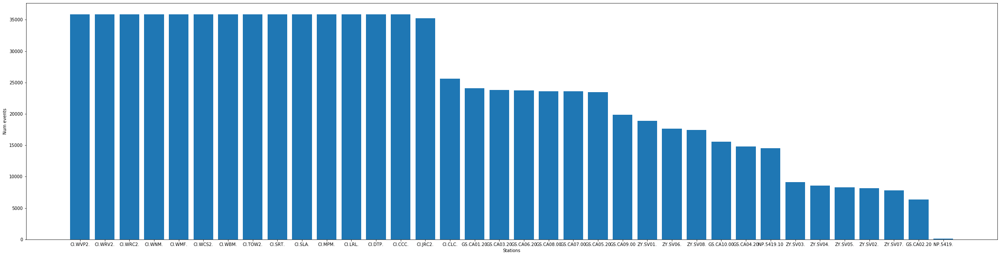

In [69]:
sorted_dict = sorted(zip(list(counts.values()), list(counts.keys())))
sorted_counts, sorted_stats = zip(*sorted_dict)
sorted_counts, sorted_stats = sorted_counts[::-1], sorted_stats[::-1]
plt.figure(figsize=(40,10))
plt.bar(sorted_stats, sorted_counts)
plt.xlabel('Stations'); plt.ylabel("Num events")
plt.show()

In [70]:
with open(os.path.join(meta_path, 'all_station_counts.json'), 'w') as fp:
    json.dump(counts, fp)  

### Step-2: Filter relevant stations and save velocities

In [4]:
num_stations = 15

with open(os.path.join(meta_path, 'all_station_counts.json')) as json_file:
    stat_counts = json.load(json_file)

print(stat_counts)

{'CI.CCC.': 35858, 'CI.DTP.': 35858, 'CI.JRC2.': 35206, 'CI.LRL.': 35858, 'CI.MPM.': 35858, 'CI.SLA.': 35858, 'CI.SRT.': 35858, 'CI.TOW2.': 35858, 'CI.WBM.': 35858, 'CI.WCS2.': 35858, 'CI.WMF.': 35858, 'CI.WNM.': 35858, 'CI.WRC2.': 35858, 'CI.WRV2.': 35858, 'CI.WVP2.': 35858, 'GS.CA01.20': 24076, 'GS.CA03.20': 23836, 'GS.CA05.20': 23499, 'GS.CA06.20': 23747, 'GS.CA07.00': 23633, 'GS.CA08.00': 23633, 'GS.CA09.00': 19846, 'GS.CA10.00': 15593, 'NP.5419.10': 14526, 'ZY.SV01.': 18914, 'ZY.SV06.': 17628, 'ZY.SV08.': 17451, 'CI.CLC.': 25627, 'GS.CA04.20': 14837, 'ZY.SV02.': 8140, 'ZY.SV03.': 9145, 'ZY.SV04.': 8602, 'GS.CA02.20': 6360, 'ZY.SV05.': 8265, 'ZY.SV07.': 7804, 'NP.5419.': 136}


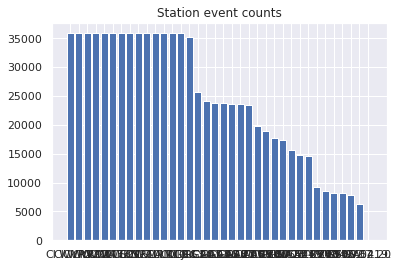

('CI.WVP2.', 'CI.WRV2.', 'CI.WRC2.', 'CI.WNM.', 'CI.WMF.', 'CI.WCS2.', 'CI.WBM.', 'CI.TOW2.', 'CI.SRT.', 'CI.SLA.', 'CI.MPM.', 'CI.LRL.', 'CI.DTP.', 'CI.CCC.', 'CI.JRC2.')
(35858, 35858, 35858, 35858, 35858, 35858, 35858, 35858, 35858, 35858, 35858, 35858, 35858, 35858, 35206)


In [7]:
sorted_dict = sorted(zip(list(stat_counts.values()), list(stat_counts.keys())))
sorted_counts, sorted_stats = zip(*sorted_dict)
sorted_counts, sorted_stats = sorted_counts[::-1], sorted_stats[::-1]
plt.bar(sorted_stats, sorted_counts)
plt.title("Station event counts")
plt.show()

master_stations = sorted_stats[:num_stations]
print(master_stations)
print(sorted_counts[:num_stations])

In [8]:
## Create array of dates
dates = sorted([entry.name.split(".")[0] for entry in list(os.scandir(raw_path)) if "npy" in entry.name])
print(sorted(dates))
print(len(dates))

['2019-06-01', '2019-06-02', '2019-06-03', '2019-06-04', '2019-06-05', '2019-06-06', '2019-06-07', '2019-06-08', '2019-06-09', '2019-06-10', '2019-06-11', '2019-06-12', '2019-06-13', '2019-06-14', '2019-06-15', '2019-06-16', '2019-06-17', '2019-06-18', '2019-06-19', '2019-06-20', '2019-06-21', '2019-06-22', '2019-06-23', '2019-06-24', '2019-06-25', '2019-06-26', '2019-06-27', '2019-06-28', '2019-06-29', '2019-06-30', '2019-07-01', '2019-07-02', '2019-07-03', '2019-07-04', '2019-07-05', '2019-07-06', '2019-07-07', '2019-07-08', '2019-07-09', '2019-07-10', '2019-07-11', '2019-07-12', '2019-07-13', '2019-07-14', '2019-07-15', '2019-07-16', '2019-07-17', '2019-07-18', '2019-07-19', '2019-07-20', '2019-07-21', '2019-07-22', '2019-07-23', '2019-07-24', '2019-07-25', '2019-07-26', '2019-07-27', '2019-07-28', '2019-07-29', '2019-07-30', '2019-07-31', '2019-08-01', '2019-08-02', '2019-08-03', '2019-08-04', '2019-08-05', '2019-08-06', '2019-08-07', '2019-08-08', '2019-08-09', '2019-08-10', '2019

In [25]:
if not os.path.exists(relevant_path):
    os.mkdir(relevant_path)

print("Extracting data for stations: {}".format(master_stations))
np.save(os.path.join(relevant_path, "stations.npy"), master_stations)


for date in tqdm(dates):
    date_data = os.path.join(raw_path, date+".npy")
#     print("Loading data from date {}".format(date))
    date_arr = np.load(date_data)
    
    ## look for stations for that day (metadata)
    station_meta = os.path.join(meta_path, date+"_stations.npy")
#     print("\tLoading metadata from {}".format(station_meta))
    date_stations = np.load(station_meta)
    delete_date = False
    stats_for_date = []
#     print("\tStations for date {}: {}".format(date, date_stations))

    for master in master_stations: 
        if master not in date_stations: 
            delete_date = True
            break            
        idx_date = date_arr[date_stations == master]
#         print(idx)
#         stats_for_date.append(date_arr[idx, :, :,])
        stats_for_date.append(idx_date)

    if delete_date is True: 
        print("\tDeleting date {}".format(date))
        continue
    stats_for_date = np.concatenate(stats_for_date, 0)
    assert stats_for_date.shape[0] == len(master_stations)
    date_save = os.path.join(relevant_path, "{}.npy".format(date))
    stats_for_date = np.transpose(stats_for_date, [1, 0, 2, 3]) #(num_evs, stats, dim, time)
    
    ## The single line that distinguishes this from accelerations
    stats_for_date = np.cumsum(stats_for_date, axis = 3) * (1. / freq)
    
    
    stats_for_date = np.linalg.norm(stats_for_date, ord=2, axis=2)

#     print(stats_for_date.shape)
    np.save(date_save, stats_for_date)


  0%|          | 0/122 [00:00<?, ?it/s]

Extracting data for stations: ('CI.WVP2.', 'CI.WRV2.', 'CI.WRC2.', 'CI.WNM.', 'CI.WMF.', 'CI.WCS2.', 'CI.WBM.', 'CI.TOW2.', 'CI.SRT.', 'CI.SLA.', 'CI.MPM.', 'CI.LRL.', 'CI.DTP.', 'CI.CCC.', 'CI.JRC2.')


  1%|          | 1/122 [00:00<00:57,  2.10it/s]

	Stations for date 2019-06-01: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


  2%|▏         | 2/122 [00:00<00:53,  2.25it/s]

	Stations for date 2019-06-02: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-03: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


  3%|▎         | 4/122 [00:01<00:40,  2.93it/s]

	Stations for date 2019-06-04: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


  4%|▍         | 5/122 [00:01<00:41,  2.81it/s]

	Stations for date 2019-06-05: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-06: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


  6%|▌         | 7/122 [00:02<00:51,  2.25it/s]

	Stations for date 2019-06-07: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


  7%|▋         | 8/122 [00:02<00:45,  2.49it/s]

	Stations for date 2019-06-08: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-09: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 10%|▉         | 12/122 [00:03<00:24,  4.43it/s]

	Stations for date 2019-06-10: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-11: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-12: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 11%|█         | 13/122 [00:03<00:23,  4.56it/s]

	Stations for date 2019-06-13: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-14: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 12%|█▏        | 15/122 [00:04<00:23,  4.54it/s]

	Stations for date 2019-06-15: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 13%|█▎        | 16/122 [00:04<00:28,  3.72it/s]

	Stations for date 2019-06-16: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-17: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 16%|█▌        | 19/122 [00:04<00:17,  5.73it/s]

	Stations for date 2019-06-18: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-19: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-20: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 17%|█▋        | 21/122 [00:05<00:16,  6.12it/s]

	Stations for date 2019-06-21: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-22: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-23: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 20%|█▉        | 24/122 [00:05<00:14,  6.72it/s]

	Stations for date 2019-06-24: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-25: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 21%|██▏       | 26/122 [00:05<00:14,  6.43it/s]

	Stations for date 2019-06-26: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 23%|██▎       | 28/122 [00:06<00:14,  6.38it/s]

	Stations for date 2019-06-27: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-28: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 24%|██▍       | 29/122 [00:06<00:13,  7.09it/s]

	Stations for date 2019-06-29: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-06-30: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 25%|██▌       | 31/122 [00:06<00:13,  6.89it/s]

	Stations for date 2019-07-01: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 26%|██▌       | 32/122 [00:06<00:19,  4.68it/s]

	Stations for date 2019-07-02: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-07-03: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']
	Stations for date 2019-07-04: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 28%|██▊       | 34/122 [00:17<02:29,  1.70s/it]

	Stations for date 2019-07-05: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.']


 29%|██▊       | 35/122 [00:44<13:22,  9.22s/it]

	Stations for date 2019-07-06: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'NP.5419.']


 30%|██▉       | 36/122 [01:27<28:09, 19.64s/it]

	Stations for date 2019-07-07: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA02.20' 'ZY.SV03.' 'ZY.SV05.']


 30%|███       | 37/122 [01:58<32:26, 22.90s/it]

	Stations for date 2019-07-08: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'ZY.SV03.' 'ZY.SV05.'
 'ZY.SV07.']


 31%|███       | 38/122 [02:33<36:59, 26.42s/it]

	Stations for date 2019-07-09: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'NP.5419.10'
 'ZY.SV03.' 'ZY.SV05.' 'ZY.SV07.']


 32%|███▏      | 39/122 [03:24<46:45, 33.80s/it]

	Stations for date 2019-07-10: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'NP.5419.10' 'ZY.SV01.' 'ZY.SV03.' 'ZY.SV05.' 'ZY.SV07.']


 33%|███▎      | 40/122 [04:22<56:20, 41.22s/it]

	Stations for date 2019-07-11: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'NP.5419.10' 'ZY.SV01.' 'ZY.SV03.' 'ZY.SV05.'
 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 34%|███▎      | 41/122 [05:17<1:00:58, 45.17s/it]

	Stations for date 2019-07-12: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.'
 'ZY.SV07.' 'ZY.SV08.']


 34%|███▍      | 42/122 [06:15<1:05:33, 49.17s/it]

	Stations for date 2019-07-13: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.'
 'ZY.SV07.' 'ZY.SV08.']


 35%|███▌      | 43/122 [06:44<56:48, 43.14s/it]  

	Stations for date 2019-07-14: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.'
 'ZY.SV07.' 'ZY.SV08.']


 36%|███▌      | 44/122 [07:09<48:57, 37.66s/it]

	Stations for date 2019-07-15: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 37%|███▋      | 45/122 [07:33<43:07, 33.60s/it]

	Stations for date 2019-07-16: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV05.' 'ZY.SV07.' 'ZY.SV08.']


 38%|███▊      | 46/122 [07:57<38:41, 30.55s/it]

	Stations for date 2019-07-17: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV05.' 'ZY.SV07.' 'ZY.SV08.']


 39%|███▊      | 47/122 [08:21<35:55, 28.73s/it]

	Stations for date 2019-07-18: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV05.' 'ZY.SV07.']


 39%|███▉      | 48/122 [08:42<32:37, 26.46s/it]

	Stations for date 2019-07-19: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV07.']


 40%|████      | 49/122 [09:02<29:40, 24.39s/it]

	Stations for date 2019-07-20: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.'
 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 41%|████      | 50/122 [09:22<27:35, 23.00s/it]

	Stations for date 2019-07-21: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.'
 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 42%|████▏     | 51/122 [09:42<26:21, 22.27s/it]

	Stations for date 2019-07-22: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.'
 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 43%|████▎     | 52/122 [10:03<25:22, 21.74s/it]

	Stations for date 2019-07-23: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.'
 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 43%|████▎     | 53/122 [10:20<23:38, 20.56s/it]

	Stations for date 2019-07-24: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.'
 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 44%|████▍     | 54/122 [10:38<22:20, 19.72s/it]

	Stations for date 2019-07-25: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 45%|████▌     | 55/122 [10:53<20:26, 18.31s/it]

	Stations for date 2019-07-26: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA02.20' 'GS.CA03.20' 'GS.CA04.20'
 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 46%|████▌     | 56/122 [11:15<21:24, 19.47s/it]

	Stations for date 2019-07-27: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 47%|████▋     | 57/122 [11:31<19:55, 18.39s/it]

	Stations for date 2019-07-28: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 48%|████▊     | 58/122 [11:51<20:09, 18.91s/it]

	Stations for date 2019-07-29: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 48%|████▊     | 59/122 [12:04<17:54, 17.06s/it]

	Stations for date 2019-07-30: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 49%|████▉     | 60/122 [12:18<16:36, 16.07s/it]

	Stations for date 2019-07-31: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 50%|█████     | 61/122 [12:27<14:21, 14.12s/it]

	Stations for date 2019-08-01: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 51%|█████     | 62/122 [12:34<11:50, 11.84s/it]

	Stations for date 2019-08-02: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'NP.5419.10' 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 52%|█████▏    | 63/122 [12:40<10:03, 10.22s/it]

	Stations for date 2019-08-03: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 52%|█████▏    | 64/122 [12:48<09:02,  9.36s/it]

	Stations for date 2019-08-04: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 53%|█████▎    | 65/122 [12:57<08:45,  9.22s/it]

	Stations for date 2019-08-05: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 54%|█████▍    | 66/122 [13:05<08:22,  8.98s/it]

	Stations for date 2019-08-06: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 55%|█████▍    | 67/122 [13:12<07:39,  8.35s/it]

	Stations for date 2019-08-07: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV06.'
 'ZY.SV08.']


 56%|█████▌    | 68/122 [13:19<07:14,  8.04s/it]

	Stations for date 2019-08-08: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV06.'
 'ZY.SV08.']


 57%|█████▋    | 69/122 [13:27<07:05,  8.03s/it]

	Stations for date 2019-08-09: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV06.' 'ZY.SV08.']


 57%|█████▋    | 70/122 [13:35<06:52,  7.94s/it]

	Stations for date 2019-08-10: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV03.' 'ZY.SV06.' 'ZY.SV08.']


 58%|█████▊    | 71/122 [13:44<06:57,  8.18s/it]

	Stations for date 2019-08-11: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV08.']


 59%|█████▉    | 72/122 [13:54<07:18,  8.76s/it]

	Stations for date 2019-08-12: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 60%|█████▉    | 73/122 [14:05<07:48,  9.57s/it]

	Stations for date 2019-08-13: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 61%|██████    | 74/122 [14:15<07:33,  9.46s/it]

	Stations for date 2019-08-14: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV07.' 'ZY.SV08.']


 61%|██████▏   | 75/122 [14:25<07:41,  9.81s/it]

	Stations for date 2019-08-15: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.'
 'ZY.SV07.' 'ZY.SV08.']


 62%|██████▏   | 76/122 [14:34<07:21,  9.59s/it]

	Stations for date 2019-08-16: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV07.'
 'ZY.SV08.']


 63%|██████▎   | 77/122 [14:43<06:55,  9.24s/it]

	Stations for date 2019-08-17: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV07.'
 'ZY.SV08.']


 64%|██████▍   | 78/122 [14:52<06:46,  9.25s/it]

	Stations for date 2019-08-18: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 65%|██████▍   | 79/122 [15:00<06:20,  8.84s/it]

	Stations for date 2019-08-19: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 66%|██████▌   | 80/122 [15:09<06:13,  8.89s/it]

	Stations for date 2019-08-20: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 66%|██████▋   | 81/122 [15:16<05:46,  8.46s/it]

	Stations for date 2019-08-21: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 67%|██████▋   | 82/122 [15:25<05:41,  8.53s/it]

	Stations for date 2019-08-22: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 68%|██████▊   | 83/122 [15:37<06:14,  9.59s/it]

	Stations for date 2019-08-23: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 69%|██████▉   | 84/122 [15:51<06:58, 11.01s/it]

	Stations for date 2019-08-24: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 70%|██████▉   | 85/122 [16:01<06:37, 10.75s/it]

	Stations for date 2019-08-25: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 70%|███████   | 86/122 [16:11<06:14, 10.40s/it]

	Stations for date 2019-08-26: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 71%|███████▏  | 87/122 [16:20<05:52, 10.08s/it]

	Stations for date 2019-08-27: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 72%|███████▏  | 88/122 [16:29<05:27,  9.64s/it]

	Stations for date 2019-08-28: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 73%|███████▎  | 89/122 [16:37<05:00,  9.10s/it]

	Stations for date 2019-08-29: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 74%|███████▍  | 90/122 [16:44<04:31,  8.49s/it]

	Stations for date 2019-08-30: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 75%|███████▍  | 91/122 [16:50<04:05,  7.92s/it]

	Stations for date 2019-08-31: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 75%|███████▌  | 92/122 [16:59<04:00,  8.00s/it]

	Stations for date 2019-09-01: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 76%|███████▌  | 93/122 [17:07<03:53,  8.05s/it]

	Stations for date 2019-09-02: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV06.' 'ZY.SV08.']


 77%|███████▋  | 94/122 [17:15<03:48,  8.16s/it]

	Stations for date 2019-09-03: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.'
 'ZY.SV08.']


 78%|███████▊  | 95/122 [17:23<03:35,  7.99s/it]

	Stations for date 2019-09-04: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV08.']


 79%|███████▊  | 96/122 [17:28<03:08,  7.26s/it]

	Stations for date 2019-09-05: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV07.']


 80%|███████▉  | 97/122 [17:33<02:44,  6.59s/it]

	Stations for date 2019-09-06: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV07.']


 80%|████████  | 98/122 [17:38<02:26,  6.12s/it]

	Stations for date 2019-09-07: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV07.']


 81%|████████  | 99/122 [17:44<02:18,  6.03s/it]

	Stations for date 2019-09-08: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'ZY.SV01.' 'ZY.SV02.' 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.'
 'ZY.SV07.']


 82%|████████▏ | 100/122 [17:54<02:36,  7.12s/it]

	Stations for date 2019-09-09: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV07.']


 83%|████████▎ | 101/122 [17:59<02:17,  6.56s/it]

	Stations for date 2019-09-10: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.' 'ZY.SV02.'
 'ZY.SV03.' 'ZY.SV04.' 'ZY.SV05.' 'ZY.SV06.' 'ZY.SV07.']


 84%|████████▎ | 102/122 [18:04<01:59,  5.98s/it]

	Stations for date 2019-09-11: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA06.20' 'GS.CA07.00'
 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'ZY.SV01.']


 84%|████████▍ | 103/122 [18:08<01:43,  5.47s/it]

	Stations for date 2019-09-12: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00']


 85%|████████▌ | 104/122 [18:13<01:34,  5.24s/it]

	Stations for date 2019-09-13: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00']


 86%|████████▌ | 105/122 [18:18<01:26,  5.09s/it]

	Stations for date 2019-09-14: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00']


 87%|████████▋ | 106/122 [18:22<01:20,  5.03s/it]

	Stations for date 2019-09-15: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00']


 88%|████████▊ | 107/122 [18:26<01:07,  4.51s/it]

	Stations for date 2019-09-16: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00']


 89%|████████▊ | 108/122 [18:28<00:55,  3.93s/it]

	Stations for date 2019-09-17: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']


 89%|████████▉ | 109/122 [18:31<00:46,  3.61s/it]

	Stations for date 2019-09-18: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']


 90%|█████████ | 110/122 [18:34<00:41,  3.43s/it]

	Stations for date 2019-09-19: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'NP.5419.10']


 91%|█████████ | 111/122 [18:36<00:33,  3.05s/it]

	Stations for date 2019-09-20: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'NP.5419.10']


 93%|█████████▎| 113/122 [18:41<00:24,  2.73s/it]

	Stations for date 2019-09-21: ['CI.CCC.' 'CI.DTP.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.' 'CI.TOW2.'
 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.' 'CI.WVP2.'
 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']
	Deleting date 2019-09-21


 93%|█████████▎| 114/122 [18:43<00:19,  2.41s/it]

	Stations for date 2019-09-22: ['CI.CCC.' 'CI.DTP.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.' 'CI.TOW2.'
 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.' 'CI.WVP2.'
 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20' 'GS.CA07.00'
 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']
	Deleting date 2019-09-22
	Stations for date 2019-09-23: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']


 94%|█████████▍| 115/122 [18:46<00:18,  2.68s/it]

	Stations for date 2019-09-24: ['CI.CCC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.' 'CI.SRT.'
 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.' 'CI.WRV2.'
 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']


 95%|█████████▌| 116/122 [18:49<00:15,  2.55s/it]

	Stations for date 2019-09-25: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']


 96%|█████████▌| 117/122 [18:51<00:12,  2.56s/it]

	Stations for date 2019-09-26: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'NP.5419.10']


 97%|█████████▋| 118/122 [18:55<00:11,  2.87s/it]

	Stations for date 2019-09-27: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'NP.5419.10']


 98%|█████████▊| 119/122 [18:58<00:08,  2.95s/it]

	Stations for date 2019-09-28: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']


 98%|█████████▊| 120/122 [19:01<00:06,  3.11s/it]

	Stations for date 2019-09-29: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA05.20' 'GS.CA06.20'
 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00' 'NP.5419.10']


 99%|█████████▉| 121/122 [19:04<00:02,  2.87s/it]

	Stations for date 2019-09-30: ['CI.CCC.' 'CI.CLC.' 'CI.DTP.' 'CI.JRC2.' 'CI.LRL.' 'CI.MPM.' 'CI.SLA.'
 'CI.SRT.' 'CI.TOW2.' 'CI.WBM.' 'CI.WCS2.' 'CI.WMF.' 'CI.WNM.' 'CI.WRC2.'
 'CI.WRV2.' 'CI.WVP2.' 'GS.CA01.20' 'GS.CA03.20' 'GS.CA04.20' 'GS.CA05.20'
 'GS.CA06.20' 'GS.CA07.00' 'GS.CA08.00' 'GS.CA09.00' 'GS.CA10.00'
 'NP.5419.10']


100%|██████████| 122/122 [19:07<00:00,  9.41s/it]


(516, 15, 6000) (516, 15, 6000)


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


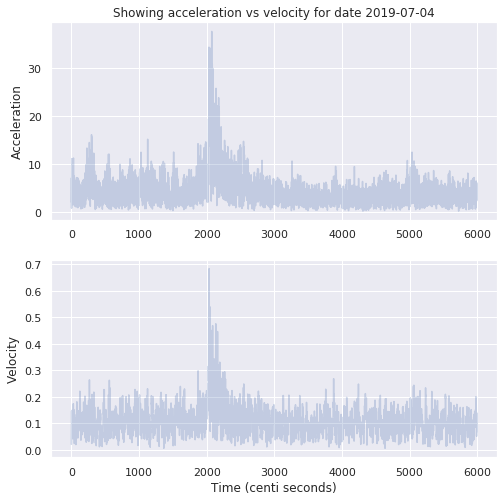

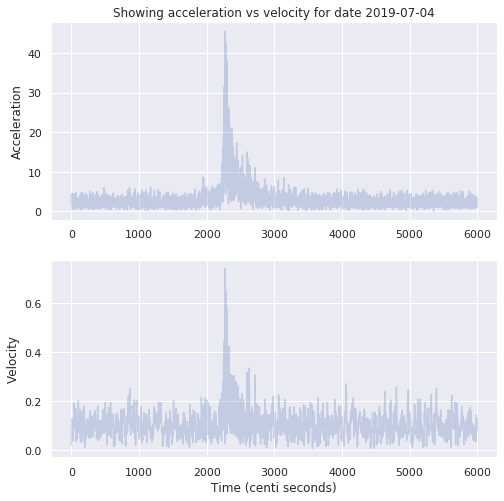

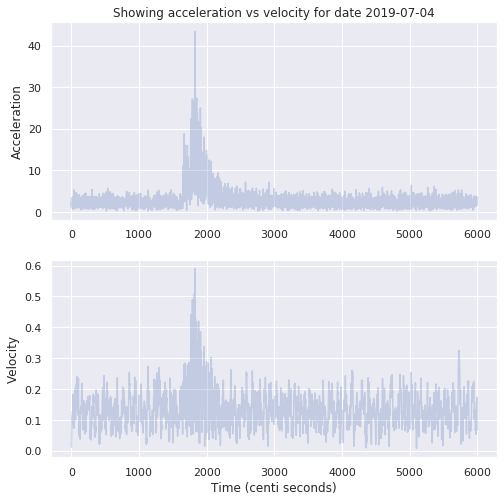

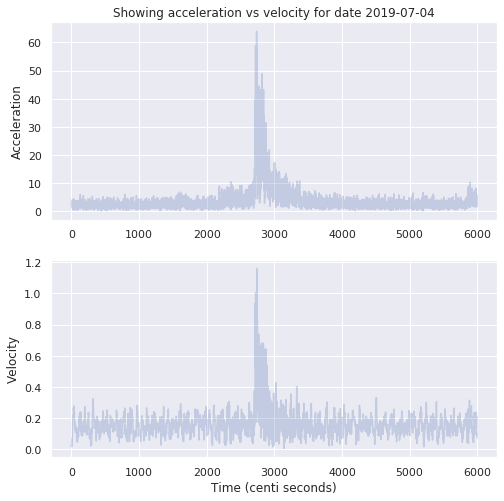

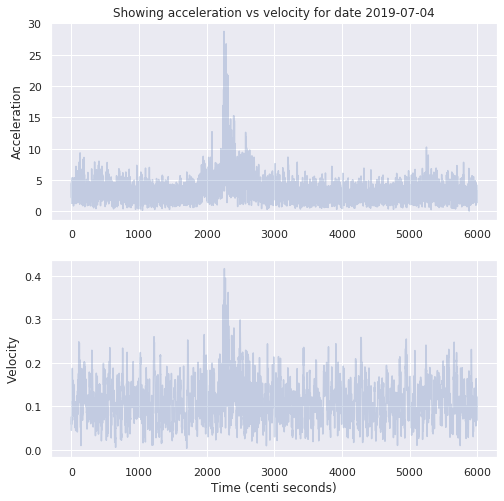

...

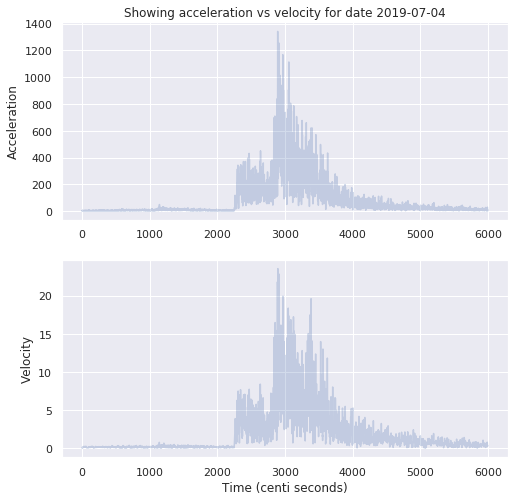

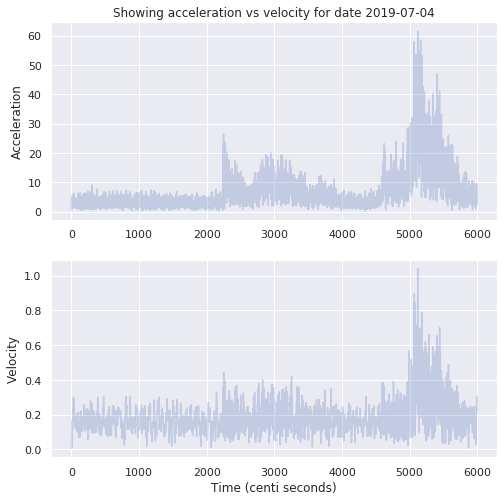

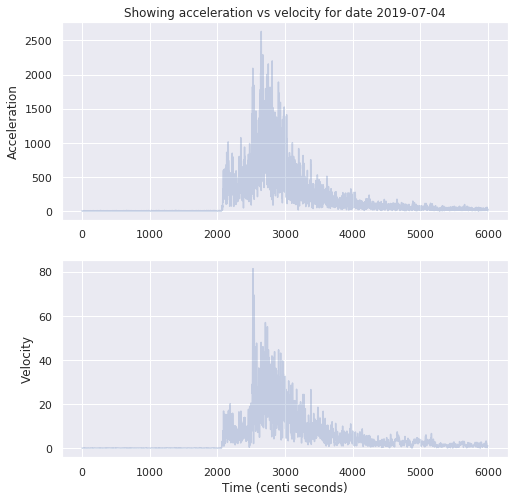

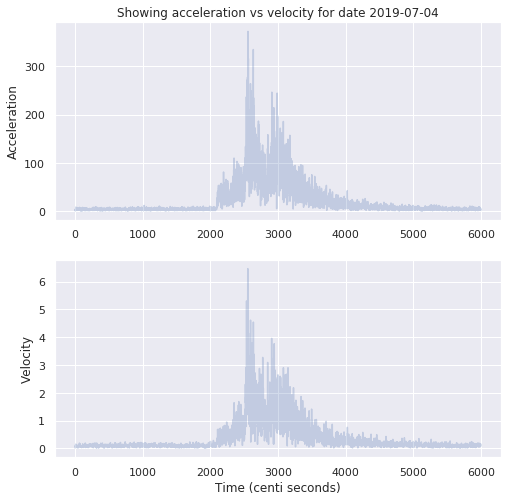

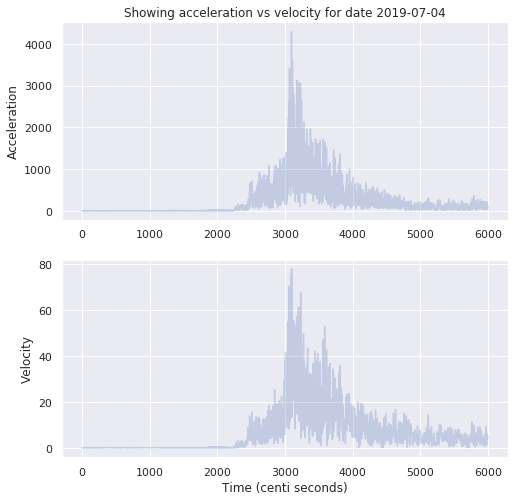

In [27]:
## Visualize a randomly chosen velocity date's acceleration and velocity
# test_date = np.random.choice(dates)
test_date = '2019-07-04'
acc_tensor = np.load(os.path.join(os.path.join(data_dir, "acc", "relevant_stations"), test_date + ".npy"))
vel_tensor = np.load(os.path.join(relevant_path, test_date + ".npy"))
print(acc_tensor.shape, vel_tensor.shape)

for i in range(acc_tensor.shape[0]):
    print(i)
    plt.figure(figsize=(8, 8))
    plt.subplot(2, 1, 1)
    plt.title("Showing acceleration vs velocity for date {}".format(test_date))
    plt.plot(acc_tensor[i, 0, :], alpha=0.25)
    plt.ylabel("Acceleration")

    plt.subplot(2, 1, 2)
    plt.plot(vel_tensor[i, 0, :], alpha=0.25)
    plt.ylabel("Velocity")
    plt.xlabel("Time (centi seconds)")

plt.show()

### Step-3: Compress via subsampling

In [28]:
if not os.path.exists(compressed_path):
    os.mkdir(compressed_path)
    
files = [entry.name for entry in os.scandir(relevant_path) if "2019" in entry.name]
print(files)
print(len(files))

WIDTH = 100
for file in tqdm(files):
#     print("Processing file: {}".format(file))
    large = np.load(os.path.join(relevant_path, file))
#     print("\tBefore: ", large.shape)
    comp_shape = (large.shape[0], large.shape[1], large.shape[2] // WIDTH)
    compressed = np.zeros(comp_shape)
    for i in range(comp_shape[2]):
        compressed[:, :, i] = np.mean(large[:, :, WIDTH*i: WIDTH*(i+1)], 2)
#     print("\tAfter: ", compressed.shape)
    np.save(os.path.join(compressed_path, file), compressed)
    

['2019-06-12.npy', '2019-08-25.npy', '2019-07-31.npy', '2019-07-02.npy', '2019-07-07.npy', '2019-07-19.npy', '2019-07-17.npy', '2019-08-15.npy', '2019-08-04.npy', '2019-06-10.npy', '2019-08-10.npy', '2019-06-26.npy', '2019-09-30.npy', '2019-08-26.npy', '2019-09-13.npy', '2019-06-29.npy', '2019-08-13.npy', '2019-07-26.npy', '2019-07-21.npy', '2019-06-08.npy', '2019-07-15.npy', '2019-09-06.npy', '2019-09-11.npy', '2019-09-26.npy', '2019-06-04.npy', '2019-08-16.npy', '2019-07-18.npy', '2019-08-05.npy', '2019-07-08.npy', '2019-09-20.npy', '2019-08-12.npy', '2019-07-13.npy', '2019-09-16.npy', '2019-06-03.npy', '2019-06-30.npy', '2019-07-14.npy', '2019-07-22.npy', '2019-08-27.npy', '2019-07-25.npy', '2019-08-22.npy', '2019-06-19.npy', '2019-08-31.npy', '2019-08-11.npy', '2019-06-06.npy', '2019-06-27.npy', '2019-07-06.npy', '2019-06-07.npy', '2019-06-20.npy', '2019-08-24.npy', '2019-08-20.npy', '2019-09-23.npy', '2019-08-14.npy', '2019-06-16.npy', '2019-08-28.npy', '2019-09-29.npy', '2019-06-

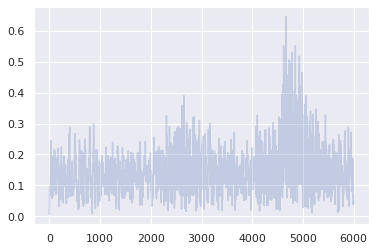

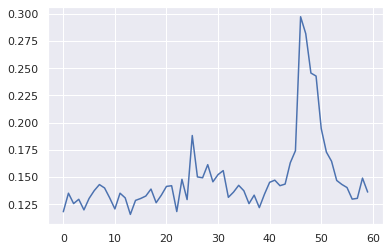

In [32]:
test_date = "2019-07-06.npy"
test_original = np.load(os.path.join(relevant_path, test_date))
test_compressed = np.load(os.path.join(compressed_path, test_date))

plt.plot(test_original[0, 0, :], alpha=0.25)
plt.show()
plt.plot(test_compressed[0, 0, :])
plt.show()